# Dx score

```{contents}
```

## Load data

In [2]:
import pandas as pd
import sys
sys.path.append('../')
from source.pacmap_functions import *

mount = '/mnt/d/'
input_path = mount + 'MethylScore/Intermediate_Files/'
output_path = mount + 'MethylScore/Processed_Data/'

# read df_discovery and df_test
df_discovery = pd.read_pickle(
    input_path+'3308samples_333059cpgs_withbatchcorrection_bvalues.pkl').sort_index()

df_test = pd.read_pickle(
    input_path+'201samples_357839cpgs_withbatchcorrection_bvalues.pkl').sort_index()

# Load clinical data
discovery_clinical_data = pd.read_csv(input_path+'discovery_clinical_data.csv',
                                      low_memory=False, index_col=0)

# Load clinical data
test_clinical_data = pd.read_csv(input_path+'validation_clinical_data.csv',
                                        low_memory=False, index_col=0)

In [ ]:
# import train_test_split function
from sklearn.model_selection import train_test_split

discovery_clinical_data2 = discovery_clinical_data[~discovery_clinical_data['WHO 2022 Diagnosis'].isna()]

df_discovery2 = df_discovery.loc[discovery_clinical_data2.index]

# Train test split `df_discovery` into `df_train` and `df_validation`
_, df_validation = train_test_split(df_discovery2, test_size=0.1, random_state=42, 
                                            stratify=discovery_clinical_data2['WHO 2022 Diagnosis'])

# Define `df_train` as the rest of `df_discovery`
df_train = df_discovery[~df_discovery.index.isin(df_validation.index)]

# Define `train_clinical_data` and `validation_clinical_data`
train_clinical_data = discovery_clinical_data.loc[df_train.index]
validation_clinical_data = discovery_clinical_data.loc[df_validation.index]

# Adjust clinical data
train_clinical_data['Train-Validation-Test'] = 'Train Samples'
validation_clinical_data['Train-Validation-Test'] = 'Validation Samples'
test_clinical_data['Train-Validation-Test'] = 'Test Samples'

train_clinical_data['Batch'] = df_train['Batch']
validation_clinical_data['Batch'] = df_validation['Batch']
test_clinical_data['Batch'] = 'St Jude Children\'s'

## Select CpGs in both train and test

In [8]:
# use overlapping features between df_discovery and df_test
common_features = [x for x in df_discovery.columns if x in df_test.columns]

# apply `common_features` to both df_discovery and df_test
df_train = df_train[common_features]
df_validation = df_validation[common_features]
df_test = df_test[common_features]

output_notebook()

Loading BokehJS ...

In [9]:
# Combine df_validation and df_test
df_validation_test = pd.concat([df_validation, df_test])

# Combine validation_clinical_data and test_clinical_data
validation_test_clinical_data = pd.concat([validation_clinical_data, test_clinical_data])

## Acute Leukemia Methylome Atlas

In [10]:
clinical_trials = [
                    'NOPHO ALL92-2000', 
                    'AAML0531',
                    'AAML1031',
                    'Beat AML Consortium',
                    'TCGA AML',
                    'CETLAM SMD-09 (MDS-tAML)',
                    'French GRAALL 2003–2005',
                    'TARGET ALL',
                    'AAML03P1',
                    'Japanese AML05',
                    'CCG2961'
                    ]

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow', 'Bone Marrow Normal',
                'Primary Blood Derived Cancer - Peripheral Blood', 'Blood Derived Normal',
                'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
                'Recurrent Blood Derived Cancer - Peripheral Blood'
                ]

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'WHO 2022 Diagnosis',
        'ELN 2022 Diagnosis','Hematopoietic Entity' ,'Train-Validation-Test', 'Batch']

components = [2,5]
for n in components:
    processor = DataProcessor(train_clinical_data.copy(),
                              df_train,
                              clinical_trials,
                              sample_types,
                              cols, 
                              n_components=n,
                              common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_dx_al', 
                              df_test=df_validation_test.copy(),
                              test_clinical_data=validation_test_clinical_data.copy())
    
    processor.filter_data()
    processor.apply_pacmap() # learn PaCMAP on the training data
    processor.apply_pacmap_test() # apply PaCMAP to the test data
    processor.join_labels() # join clinical data to the embedding

    # Save output
    processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_model_dx_al.csv')

The PaCMAP instance is successfully saved at /mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_dx_al)`.
The PaCMAP instance is successfully saved at /mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_dx_al)`.


In [11]:
df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_model_dx_al.csv', index_col=0)

# Concatenate discovery and validation clinical data
clinical_data = pd.concat([train_clinical_data, validation_clinical_data, test_clinical_data]).loc[df['index']]

# Select columns to plot
cols = ['WHO 2022 Diagnosis','ELN 2022 Diagnosis','Hematopoietic Entity','FAB', 'FLT3 ITD', 'Age (group years)',
        'Complex Karyotype' ,'Batch', 'Sex', 'MRD 1 Status',
        'Leucocyte counts (10⁹/L)', 'Risk Group', 'Race or ethnic group', 'Trisomy 8 Status',
        'Clinical Trial', 'Vital Status','First Event','Sample Type', 'Train-Validation-Test']

# Join clinical data to the embedding
df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

plotter = BokehPlotter(df, cols, get_custom_color_palette(),
                       title='',
                        x_range=(-45, 45), y_range=(-45, 45),
                        datapoint_size=4, tooltip_dx_cols='WHO 2022 Diagnosis',
                        width=1000, height=600)
plotter.plot()

## Patient Characteristics Table

In [12]:
# from tableone import TableOne

# columns = ['Hematopoietic Entity',
#             'Clinical Trial',]

# df_train = df[df['Train Test']=='Discovery (train) Samples']

# mytable_cog = TableOne(df_train.reset_index(), columns,
#                         overall=False, missing=False,
#                         pval=False, pval_adjust=False,
#                         htest_name=True,dip_test=True,
#                         tukey_test=True, normal_test=True,

#                         order={'FLT3 ITD':['Yes','No'],
#                                 'Age (group years)':['0-5','5-13','13-39','39-60'],
#                                 'MRD 1 Status': ['Positive'],
#                                 'Risk Group': ['High Risk', 'Standard Risk'],
#                                 'FLT3 ITD': ['Yes'],
#                                 'Leucocyte counts (10⁹/L)': ['≥30'],
#                                 'Age group (years)': ['≥10']})

# # mytable_cog.to_excel('data/tableone_Dx_pacmap.xlsx')
# # mytable_cog.to_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv')

# mytable_cog.tabulate(tablefmt="html", 
#                         # headers=[score_name,"",'Missing','Discovery','Validation','p-value','Statistical Test']
#                         )

## Load data for multi-class classifier

In [13]:
import pandas as pd
import numpy as np

input_path = '/mnt/d/MethylScore/Intermediate_Files/'
output_path = '/mnt/d/MethylScore/Processed_Data/'

n_components = 5

# Create a list of strings containing "PaCMAP " + the number of components
components = [f'PaCMAP {i}' for i in range(1, n_components+1)]

# Load pacmap output data
df = pd.read_csv(output_path+f'pacmap_output/pacmap_{n_components}d_model_dx_al.csv', index_col=0)

## Preprocess data

### Select WHO 2022 annotated samples

In [14]:
# drop the samples with missing labels for the ELN AML 2022 Diagnosis
df_original = df.copy()
df = df[~df['WHO 2022 Diagnosis'].isna()]

# drop samples from `df['Hematopoietic Entity']` that contain `ALL` and `MPAL` and `Otherwise-Normal Control` and `APL`
# df = df[df['Hematopoietic Entity'].isin(['Acute myeloid leukemia (AML)'])]

# print the number of samples dropped and the amount remaining
print(df_original.shape[0]-df.shape[0], 'samples removed.'\
, df.shape[0], 'samples remaining.')

910 samples removed. 2359 samples remaining.


### Select Dx subtypes with at least 10 samples

In [15]:
df['WHO 2022 Diagnosis'].value_counts(dropna=False)

WHO 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               364
T-ALL NOS                                  242
AML with mutated NPM1                      226
AML with t(8;21); RUNX1::RUNX1T1           205
AML with inv(16); t(16;16); CBFB::MYH11    201
B-ALL with hyperdiploidy                   190
B-ALL with t(12;21); ETV6::RUNX1           163
MDS-related; secondary myeloid             152
Otherwise-Normal Control                   139
AML with NUP98-fusion                       95
AML with mutated CEBPA                      85
APL with t(15;17); PML::RARA                31
AML with CBFA2T3::GLIS2                     30
B-ALL with t(v;11q23); KMT2A-r              28
AML with t(6;9); DEK::NUP214                27
MPAL T-Lymphoblastic/Myeloid                25
B-ALL with t(1;19); TCF3::PBX1              23
B-ALL dic(9;20)                             20
MPAL B-Lymphoblastic/Myeloid                19
B-ALL with t(9;22); BCR::ABL1               19
AML with ETV6 fusion                     

In [16]:
# exclude the samples with mixed phenotypes and Down syndrome and t(9;22)(q34.1;q11.2)/BCR::ABL1
df2 = df[~df['WHO 2022 Diagnosis'].isin([
                                    # 'MPAL with t(v;11q23.3)/KMT2A-r',
                                    #    'B-ALL with hypodiploidy',
                                       # 'AML with t(9;22); BCR::ABL1'
                                       ])]

# print the number of samples dropped and the amount remaining
print(df.shape[0]-df2.shape[0], 'samples removed.'\
, df2.shape[0], 'samples remaining, which includes 111 test samples')
                                       

0 samples removed. 2359 samples remaining, which includes 111 test samples


### Define X and y

In [17]:

# Define X and y
X = df2[components].to_numpy() # shape (n_samples=1399, n_features=5)
y = df2['WHO 2022 Diagnosis'].to_numpy() # shape (n_samples=1399,) with 11 string classes

# Split the data into train/test sets based on the `Train-Validation-Test` column
X_train = X[df2['Train-Validation-Test']=='Train Samples']
y_train = y[df2['Train-Validation-Test']=='Train Samples']
X_validation = X[df2['Train-Validation-Test']=='Validation Samples']
y_validation = y[df2['Train-Validation-Test']=='Validation Samples']
X_test = X[df2['Train-Validation-Test']=='Test Samples']
y_test = y[df2['Train-Validation-Test']=='Test Samples']

# print the number of samples in each set
print('X_train shape:', X_train.shape, 'X_test shape:', X_test.shape, 'X_validation shape:', X_validation.shape)

X_train shape: (2012, 5) X_test shape: (102, 5) X_validation shape: (245, 5)


## LightGBM

### 5 components

In [18]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score
import sys

sys.path.append('../')
from source.data_visualization_functions import plot_confusion_matrix_stacked

# param_grid = {}

# Define the parameter grid
# param_grid = {
#     'num_leaves': [100], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
#     'learning_rate': [0.01],  # learning rate
#     'n_estimators': [200],  # number of trees (or rounds)
# }

param_grid = {
    'num_leaves': [7, 15, 30, 50], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
    'learning_rate': [0.001, 0.01, 0.1],  # learning rate
    'n_estimators': [30, 50, 100, 200, 300]  # number of trees (or rounds)
}

# Initialize the LGBM Classifier
lgbm = LGBMClassifier(random_state=42, n_jobs=-1)

# Initialize StratifiedKFold
# stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42, )

# Perform grid search with stratified cross-validation
grid_search = GridSearchCV(lgbm, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted', verbose=0)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score (not final): {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  
y_pred_validation = best_model.predict(X_validation)  
y_pred_test = best_model.predict(X_test) 


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in validation: {accuracy_score(y_validation, y_pred_validation):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

Best parameters: {'learning_rate': 0.01, 'n_estimators': 200, 'num_leaves': 15}
Best cross-validation score (not final): 0.968
Overall accuracy score with best estimator in train: 0.927
Overall accuracy score with best estimator in validation: 0.702
Overall accuracy score with best estimator in test: 0.922


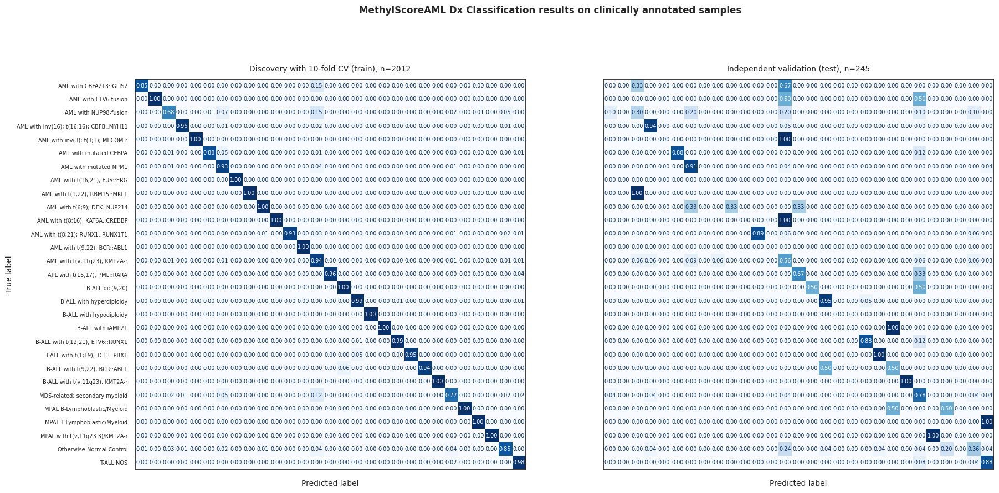

In [19]:
plot_confusion_matrix_stacked(best_model, X_train, y_train, X_validation, y_validation,
                              tick_fontsize=7, label_fontsize=7, figsize = (20,10))

In [20]:
import numpy as np
#  Select necessary columns and set the index
df_selected = df_original.set_index('index')[['PaCMAP 1', 'PaCMAP 2', 'PaCMAP 3', 'PaCMAP 4', 'PaCMAP 5']]

# Predict using the selected columns
predictions = best_model.predict(df_selected)

# Predict probabilities using the selected columns
probabilities = best_model.predict_proba(df_selected)

# Convert predictions to a Series with the same index as df_selected
predictions_series = pd.Series(predictions, index=df_selected.index, name='MethylScoreAML_Dx_predictions')

# Convert probabilities to a DataFrame with the same index as df_selected and the same columns as the classes
probabilities_df = pd.DataFrame(probabilities, index=df_selected.index, columns=best_model.classes_).round(3)

# Add " - predict_proba" to the column names
probabilities_df.columns = probabilities_df.columns + ' - predict_proba'

# Create a new column named "Confident" and set it to True if the max probability is >= 0.8
confidence_threshold = 0.8
probabilities_df['Confidence >=' + str(confidence_threshold)] = probabilities_df.max(axis=1) >= confidence_threshold

# Join predictions with the original DataFrame (already indexed)
df_joined = df_original.set_index('index').join(predictions_series).join(probabilities_df)

# # Select AML-only trials only
# df_joined = df_joined[~df_joined['Clinical Trial'].isin(['NOPHO ALL92-2000', 'French GRAALL 2003–2005','TARGET ALL', np.nan])]

# # For 'ELN AML 2022 Diagnosis', replace `na` with "AML, NOS (not otherwise specified)"
# df_joined['ELN 2022 Diagnosis'] = df_joined['ELN 2022 Diagnosis'].fillna('AML, NOS (not otherwise specified)')

# Write the final DataFrame to a CSV file
# df_joined.to_csv(output_path+'classifier_output/pacmap_5d_output_acute_leukemia_with_predictions.csv')
df_joined.to_excel('../data/pacmap_5d_output_acute_leukemia_with_predictions.xlsx')

## Gaussian Process Classifier

Best parameters: {'multi_class': 'one_vs_rest'}
Best cross-validation score: 0.963
Overall accuracy score with best estimator in train: 0.871
Overall accuracy score with best estimator in validation: 0.714
Overall accuracy score with best estimator in test: 0.922


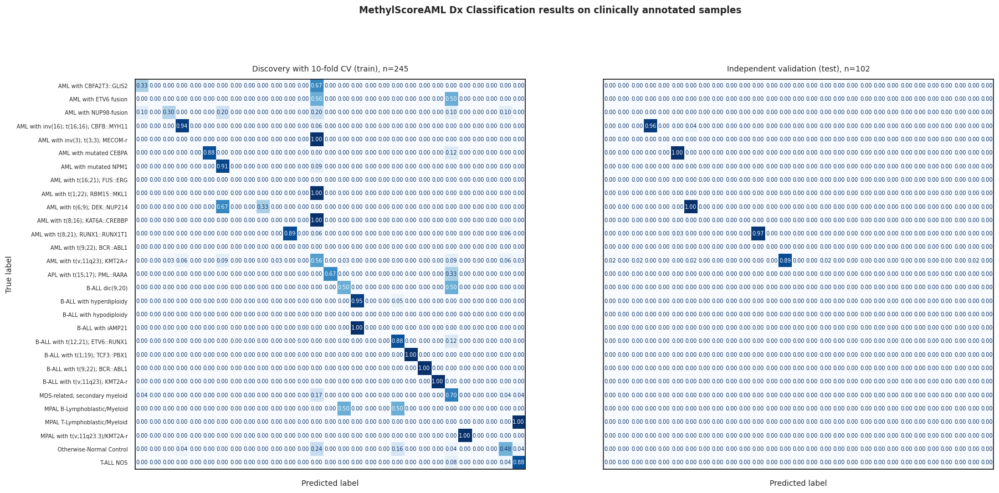

In [21]:
from sklearn.gaussian_process import GaussianProcessClassifier

# Define the parameter grid
param_grid = {
    'multi_class': ['one_vs_rest'],  # one_vs_rest is the only option for multi-class classification
}

# Initialize the Gaussian Process Classifier
gpc = GaussianProcessClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(gpc, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_test)  # Predict using the best model

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model.
y_pred_validation = best_model.predict(X_validation)  # Predict using the best model.
y_pred_test = best_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in validation: {accuracy_score(y_validation, y_pred_validation):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

plot_confusion_matrix_stacked(best_model, X_validation, y_validation, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (20,10))


## Random Forest Classifier

Best parameters: {'max_depth': 10, 'n_estimators': 200}
Best cross-validation score: 0.969
Overall accuracy score with best estimator in train: 0.903
Overall accuracy score with best estimator in validation: 0.710
Overall accuracy score with best estimator in test: 0.922


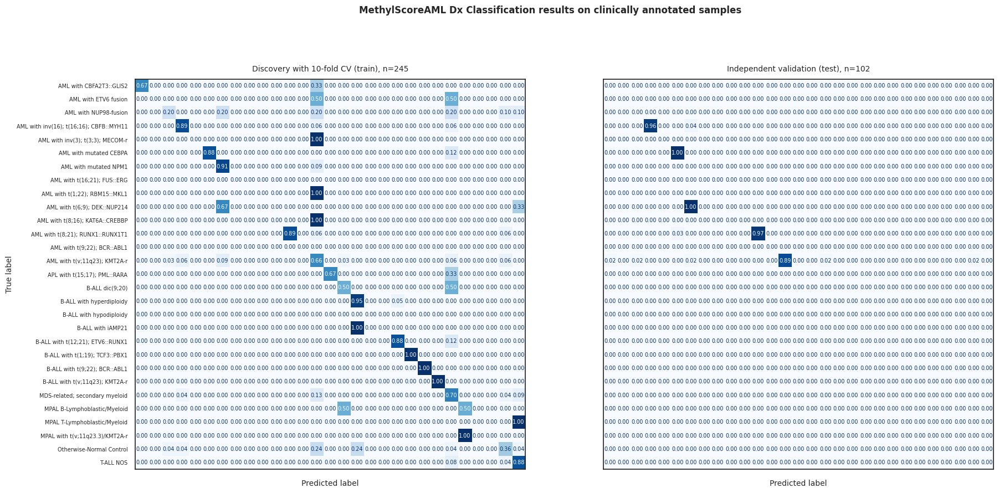

In [22]:
from sklearn.ensemble import RandomForestClassifier

# Define the parameter grid
param_grid = {
    'n_estimators': [10, 50, 100, 200],  # number of trees in the forest
    'max_depth': [None, 5, 10, 20, 50],  # maximum depth of the tree

}

# Initialize the Random Forest Classifier
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(rf, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model
y_pred_validation = best_model.predict(X_validation)  # Predict using the best model
y_pred_test = best_model.predict(X_test)  # Predict using the best model

print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in validation: {accuracy_score(y_validation, y_pred_validation):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

plot_confusion_matrix_stacked(best_model, X_validation, y_validation, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (20,10))



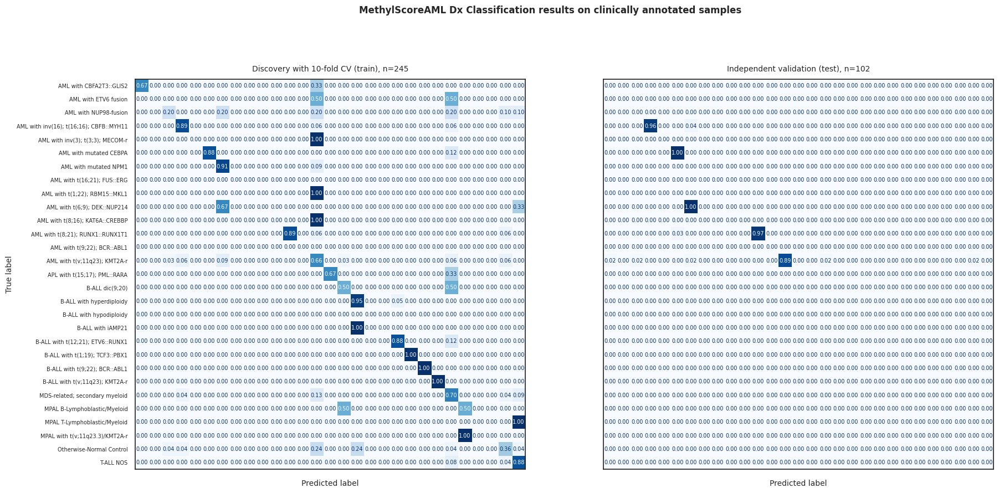

In [23]:
plot_confusion_matrix_stacked(best_model, X_validation, y_validation, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (20,10))

## Watermark

In [24]:
%load_ext watermark

In [25]:
# watermark with all libraries used in this notebook
%watermark -v -p numpy,pandas,bokeh,pacmap,itables -a Francisco_Marchi@Lamba_Lab_UF -d -m

Author: Francisco_Marchi@Lamba_Lab_UF

Python implementation: CPython
Python version       : 3.8.16
IPython version      : 8.12.2

numpy  : 1.24.3
pandas : 2.0.2
bokeh  : 3.1.1
pacmap : 0.7.0
itables: 1.5.2

Compiler    : GCC 11.3.0
OS          : Linux
Release     : 5.15.133.1-microsoft-standard-WSL2
Machine     : x86_64
Processor   : x86_64
CPU cores   : 20
Architecture: 64bit

